<a href="https://colab.research.google.com/github/RubenMcCarty/Deep-Learning-RQ/blob/main/CE1_Counting_Coins_Ruben_Quispe.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Binarization and Coin Counting Exercise**

### [Student: Ruben Quispe](https://www.linkedin.com/in/ruben-quispe-l/)

# Objective

The objective of this Computer Exercise is to illustrate the process of binarization of an image, to find efficient methods to select the best threshold automatically (Otsu) and later to use some morphological filters that allow us to obtain simple and robust results, that is, results that are kept independent of the capture, lighting, noise conditions of the image, etc. As an example of this type of analysis we will develop a script in Python that allows us to count the number of coins that appear in a photograph. Our goal will simply be to count the number of coins and not their value, but the student may wish to extend the concepts developed in practice to improve the system and analyze the values according to their relative sizes & colors.







#**Important**
To deliver the exercise print this Notebook in PDF format.

**DO NOT DELIVER THE *.IPYNB FORMAT**

#Preparing Your Drive Directory for being processed by Colab

Working in Google Colab is very easy. Colab is a web environment for executing Python which is specially dedicated to computer vision and artificial intelligence. You can test your programs in the web without installing Python or any other libraries in your computer. The environment is though for interactive development of algorithms and learning AI and Computer Vision. Google also provides access to powerful GPU K80 Tesla where you can test your programs.
In order to execute Colab you need to run Jupyter Notebooks (like this one), that combine text with code. You also have to upload all your files to Google Drive. The system will not work with your local files. (It has a mode for working with local files but in this case the execution of the code is also performed locally).
So, you will need to upload this ipynb to your drive and enter to the link colab.research.google.com where you will find the details for execution.

First step You will have to upload your files to your drive. In the next cell we mount the drive to have access to it from google.colab
Please follow the instructions

In [ ]:
# Mounting your drive to be used by Colab

from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


### Uploading the test image and conditioning

The first part of the exercise is to load an example image. The image is in color and what we will do is to pass it to gray levels. The resolution of the image is also very high so it is usually convenient to reduce it to control the computational cost of the algorithms. In practice, the resolution of the images should be sufficient to ensure that the analysis algorithms work correctly. If so, it is not necessary to use higher resolutions that would only contribute to increase the computational load.

To load the image and visualize it, we will place it in the directory in which we have downloaded the computer exercise assignment, along with the images to be analyzed and we will perform the instructions described in the next cell (remember to execute the cell using MAJ+ENTER).

In [ ]:
# We begin changing the directory. 
# You will have to define the directory where you have uploaded your images. 
# In my case it is in 'Image Computer Exercises'.
# The rest of the code opens the image, converts it to gray levels and represents it.
import os
os.chdir("/content/drive/My Drive/Colab Notebooks/IMAGE/CE1")

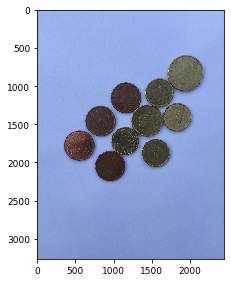

In [ ]:
from skimage import io
img = io.imread('Monedas1.JPG') # Be careful when openning a file .. It is case sensitive

io.imshow(img)

io.show()

With these instructions we will visualize the image. We are importing the submodule io (input output) from the library scikit-image (a package for image processing) and using the sentence imshow (the sentence show() especifies to show the graphics and may not be necessary in some implementations of Python)

We also could check that it is a color image and also that its size is quite large (the number of pixels are indicated in the image axis). 

It is possible to determine the size of the image executing the following instruction


In [ ]:
print(img.shape)

(3264, 2448, 3)


In [ ]:
print(img1.shape)

(1024, 1009, 3)



#**Question 1.**
Determine the size of the current image GIVING THE NUMBER OF ROWS, COLUMNS AND COLORS (we are using the instruction shape from the scikit-image python library. In the next instructions of the exercise it will be useful for you to search the documentation of this library to understand what the different examples sentences are doing)




**Answer.**

Whit command print(img.shape) we get **(3264, 2448, 3)** where, We have 3264 rows and 2448 columns and 3 is RGB.
The shape of the ndarray show that it is a three layered matrix. The first two numbers here are length and width, and the third number (i.e. 3) is for three layers: Red, Green, Blue. So, if we calculate the size of a RGB image, the total size will be counted as height x width x 3







In [ ]:
print('Image size {}'.format(img.size))
print('Maximum RGB value in this image {}'.format(img.max()))
print('Minimum RGB value in this image {}'.format(img.min()))

Image size 23970816
Maximum RGB value in this image 255
Minimum RGB value in this image 0


These values are important to verify since the eight bit color intensity is, can not be outside of the 0 to 255 range.

###Image processing in Python
scikit-image is a collection of algorithms for image processing. It is available free of charge and free of restriction. scikit-image builds on scipy.ndimage to provide a versatile set of image processing routines in Python.

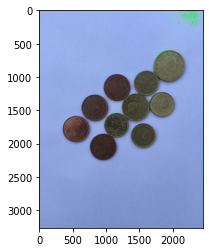

In [ ]:
#from skimage import data
import matplotlib.pyplot as plt
reddish = img[:, :, 0] > 160
img[reddish] = [0, 255, 0]
plt.imshow(img)

### Resizing the image 

To change the size of the image we will execute the following sentence (we also are importing the submodule of scikit-image for image transformations) 


In [ ]:
from skimage import transform as tf

img = tf.rescale(img,0.25,multichannel=True)

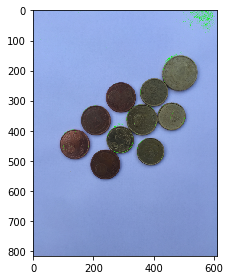

In [ ]:
io.imshow(img)
io.show()

In [ ]:
print(img.shape)

(816, 612, 3)



#**Question 2. **
Now, what is the new size of the image? What does the instruction rescale? What instruction would you run if you want the final image to have half the rows and columns of the original image? </span>


**Answer.**

The size after transforming the original image is reduced.
shape is (816, 612, 3)
row reduce from 3264 to 816, column from 2448 to 612.
As you can see the above results

### Rescale

Rescale operation resizes an image by a given scaling factor. The scaling factor can either be a single floating point value, or multiple values - one along each axis. Note that when rescale an image should perform Gaussian smoothing to avoid aliasing artifacts. See the anti_aliasing and anti_aliasing_sigma arguments to these functions [Rescale](https://scikit-image.org/docs/stable/auto_examples/transform/plot_rescale.html)





In [ ]:
# If you want to see half of the original image we only have to apply rescale to 0.5
img = tf.rescale(img,0.5,multichannel=True)
print(img.shape)

(408, 306, 3)


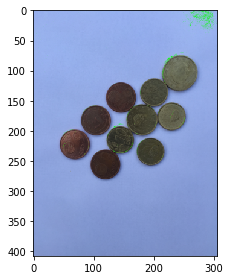

In [ ]:
io.imshow(img)
io.show()

TypeError: ignored

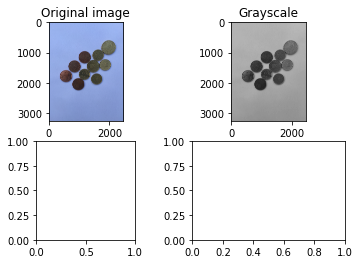

In [ ]:
#RESCALE 
# SIZE ORIGINAL(3264, 2448, 3)
from skimage import io
import numpy as np
import matplotlib.pyplot as plt
from skimage.transform import rescale

from skimage.color import rgb2gray
img = io.imread('Monedas1.JPG') 
img_gray = rgb2gray(img)

img_rescaled = rescale(img, 0.5, anti_aliasing=False)

fig, axes = plt.subplots(nrows=2, ncols=2)

ax = axes.ravel()

ax[0].imshow(img, cmap='gray')
ax[0].set_title("Original image")
ax[1].imshow(img_gray, cmap=plt.cm.gray)
ax[1].set_title("Grayscale")
ax[2].imshow(img_rescaled, cmap='gray')
ax[2].set_title("Rescaled image (aliasing)")
ax[0].set_xlim(0, 2448)
ax[0].set_ylim(3264, 0)
plt.tight_layout()
plt.show()

#**Question 3. **
Determine what are the color components of the pixel in row 225 and column 150 of the image u that you now have now in memory. Given its value, could you tell if it is a pixel corresponding to the background of the image or a coin? 

**Answer.**

The result when applying is print(img[225,150]) is [0.57843137 0.67254902 0.90980392]
* we see the intensity of red is 0.57843137, the intensity of green is 0.67254902 and the intensity of blue is .90980392
(RGB)


In [ ]:
print(img.shape)

(3264, 2448, 3)


In [ ]:
# If the image is in color the result of any pixel comes out RGB
print(img[225,150])

[156 180 242]


In [ ]:
# When the image is gray, only one color appears on the scales (225,150)
#Remember that grayscale images contain pixel values in the range from 0 to 1
print(img[225,150])

0.7034125490196078


In [ ]:
print('Type of the image : ' , type(img))

print('Shape of the image : {}'.format(img.shape))
print('Image Hight {}'.format(img.shape[0]))
print('Image Width {}'.format(img.shape[1]))
print('Dimension of Image {}'.format(img.ndim))

Type of the image :  <class 'numpy.ndarray'>
Shape of the image : (3264, 2448, 3)
Image Hight 3264
Image Width 2448
Dimension of Image 3


### Converting the image to gray levels

Now we will execute the following sentences to convert the image to gray levels. The first one is just importing the library for color transforms and the second performs conversion from color to luminance, having into account modern phosphor conventions


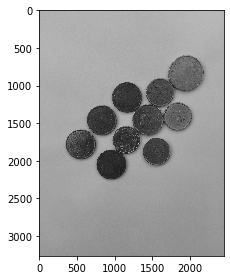

In [ ]:
from skimage import color as cl

img_g = cl.rgb2gray(img)
io.imshow(img_g)


Type: <class 'numpy.ndarray'>
dtype: uint8
shape: (303, 384)


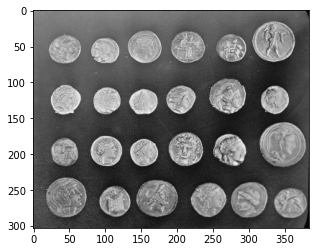

In [ ]:
# Here is just a coin test that is in the skimage data
import matplotlib.pyplot as plt
from skimage import data
coins = data.coins()
print('Type:', type(coins))
print('dtype:', coins.dtype)
print('shape:', coins.shape)

plt.imshow(coins, cmap ='gray');

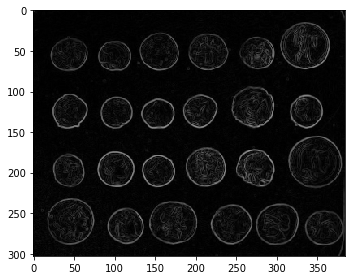

In [ ]:
from skimage import data, io, filters

image = data.coins()
# ... or any other NumPy array!
edges = filters.sobel(image)
io.imshow(edges)
io.show()

#**Question 4.**

Visualize the image img_g and discuss the differences with the original image img. Explain which transformation performs the rgb2gray function. Explain how every color is weighted in the final estimation of luminance. Determine the new size of the image. Indicate the value of the pixel in row 225 and column 150 and explains if it is consistent with the value of the pixel obtained in question 3.

**Answer.**
# RGB to Grayscale
In This case converts an image with RGB channels into an image with a single grayscale channel.

The value of each grayscale pixel is calculated as the weighted sum of the corresponding red, green and blue pixels as:
* Y =156 __R__ +  180 __G__ + 242 __B__ is the new size after apply rgb2gray is only value.

Color is the perceptual result of light in the visible region of the spectrum,
having wavelengths in the region of 400 nm to 700 nm, incident upon the
retina. Physical power (or radiance) is expressed in a spectral power distribution (SPD), often in 31 components each representing a 10 nm band.

Remember, if I apply rescale to a color image the result is 3 numbers, length, width and dimension, however if I apply rescale to a gray image the result is 1 single value which is the sum of the colors R+G+B 



**Include here the text for your answer. Write any necessary code and be clear with the answers to the different questions**



In [ ]:
# the value of the pixel in row 225 and column 150
print(img[225,150])

[156 180 242]


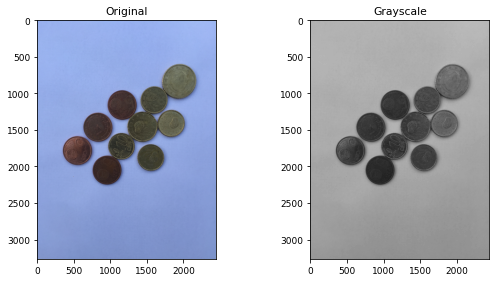

In [ ]:
import matplotlib.pyplot as plt

img = io.imread('Monedas1.JPG')

original = img
img_g = rgb2gray(original)

fig, axes = plt.subplots(1, 2, figsize=(8, 4))
ax = axes.ravel()

ax[0].imshow(original)
ax[0].set_title("Original")
ax[1].imshow(grayscale, cmap=plt.cm.gray)
ax[1].set_title("Grayscale")

fig.tight_layout()
plt.show()

### Image Thresholding

The next step is image thresholding and conversion to two levels: black and white. To do this, it is necessary to determine the binarization threshold. To determine the binarization threshold, it is often useful to analyze the histogram of the image. The next sequence of instructions will show the histogram of the image.

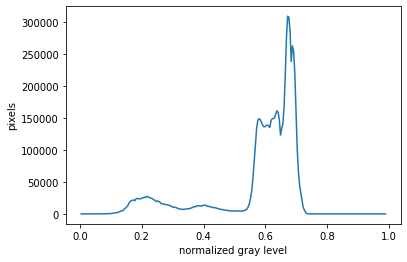

In [ ]:
from skimage import exposure as iml #importing scikit-image submodule to compute histograms
import matplotlib.pyplot as plt     #importing libraries for ploting

hist, bins= iml.histogram(img_g)

plt.xlabel('normalized gray level')
plt.ylabel('pixels')
plt.plot(bins,hist)
plt.show()

# **Question 5.**
Taking into account the graph shown by the above instruction, select the level of the binarization threshold that you consider appropriate.

**Answer.**

In digital image processing, thresholding is the simplest method of segmenting images. From a grayscale image, thresholding can be used to create binary images.
 In thresholding, we convert an image from colour or grayscale into a binary image, i.e., one that is simply black and white. Most frequently, we use thresholding as a way to select areas of interest of an image, while ignoring the parts we are not concerned with. we are going to use skimage functions to perform thresholding. Then, we will use the masks returned by these functions to select the parts of an image we are interested in.







The binarization threshold proposed in the previous question will be assigned to the threshold variable and we will perform the conversion of the image to a black and white image.

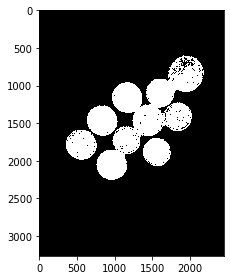

In [ ]:
th1= 0.45 # Change this line by your binarization threshold, 
         # 0 <= th1 <= 1, the example is set to 0.2 but should be changed
img_b = (img_g <= th1).astype(float)

io.imshow(img_b)
io.show()

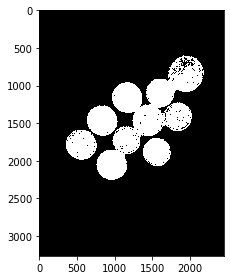

In [ ]:
th1= 0.45 # Change this line by your binarization threshold, 
         # 0 <= th1 <= 1, the example is set to 0.2 but should be changed
img_b = img_g <= th1
img_b = img_b*1.0

io.imshow(img_b)
io.show()

We see our image in gray, has a gray background, most of the pixels in the image are gray. This corresponds nicely to what we see in the histogram, there is a peak near the value of 0.7. If we want to select the shapes of coins and not the background, we want to turn off the gray background pixels, while leaving the pixels for the shapes turned on. So, we should choose a value of t somewhere before the large peak and turn pixels above that value “off”. Let us choose t=0.5.

We see that there is some noise.

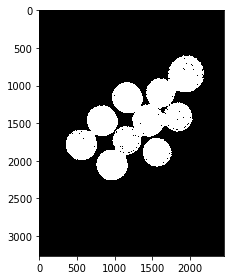

In [ ]:
th1= 0.5 # Change this line by your binarization threshold, 
         # 0 <= th1 <= 1, the example is set to 0.2 but should be changed
img_b = (img_g <= th1).astype(float)

io.imshow(img_b)
io.show()

# **Question 6.**
Observe the result obtained and discuss it. Have you been able to get an appropriate threshold value on the first test? Or has it been necessary to carry out a threshold adjustment process from the observed results?

**Answer.**


We see that there is some noise.


To apply the threshold t, we can use the numpy comparison operators to create a mask. Here, we want to turn “on” all pixels which have values smaller than the threshold, so we use the less operator < to compare the blurred_image to the threshold t. The operator returns a mask, that we capture in the variable binary_mask. It has only one channel, and each of its values is either 0 or 1. The binary mask created by the thresholding operation can be shown with plt.imshow, where the False entries are shown as black pixels (0-valued) and the True entries are shown as white pixels (1-valued). [Thresholding](https://datacarpentry.org/image-processing/07-thresholding/)


### What makes a good threshold?
As is often the case, the answer to this question is “it depends”. In the example above, we could have just switched off all the white background pixels by choosing t=07, but this would leave us with some background noise in the mask image. On the other hand, if we choose too low a value for the threshold, we could lose some of the shapes of coins.



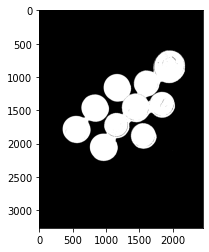

In [ ]:
# create a mask based on the threshold
import numpy as np
import glob
import matplotlib.pyplot as plt
import skimage.io
import skimage.color
import skimage.filters
#%matplotlib widget
img_g = cl.rgb2gray(img)
blurred_image = skimage.filters.gaussian(img_g, sigma=1.0)

t = 0.5
binary_mask = blurred_image < t

fig, ax = plt.subplots()
plt.imshow(binary_mask, cmap="gray")
plt.show()


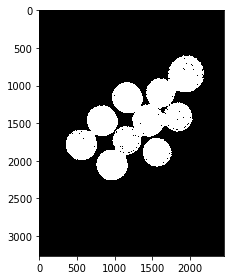

In [ ]:
# as we can see there is noise with th = 0.7
t = 0.7
img_b = (img_g <= th1).astype(float)

io.imshow(img_b)
io.show()

When we apply the binary_mask we get a good result for th =0.5, without noise, now when we apply to the original colored image. What we are left with is only the colored shapes from the original.

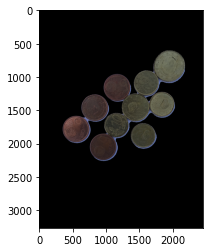

In [ ]:
selection = img.copy()
selection[~binary_mask] = 0

fig, ax = plt.subplots()
plt.imshow(selection)
plt.show()


We use Gaussian blur with a sigma of 1.0 to denoise the root image. Let us look at the grayscale histogram of the denoised image.



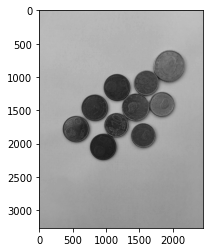

In [ ]:
# convert the image to grayscale
gray_image = skimage.color.rgb2gray(img)

# blur the image to denoise
blurred_image = skimage.filters.gaussian(gray_image, sigma=1.0)

fig, ax = plt.subplots()
plt.imshow(blurred_image, cmap="gray")
plt.show()

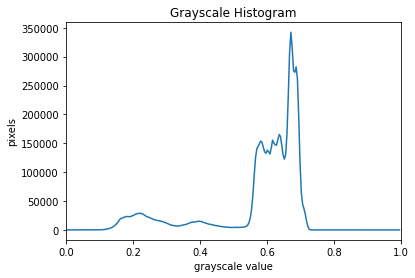

In [ ]:
# create a histogram of the blurred grayscale image
histogram, bin_edges = np.histogram(blurred_image, bins=256, range=(0.0, 1.0))

fig, ax = plt.subplots()
plt.plot(bin_edges[0:-1], histogram)
plt.title("Grayscale Histogram")
plt.xlabel("grayscale value")
plt.ylabel("pixels")
plt.xlim(0, 1.0)
plt.show()

I illustrate how to apply one of these [thresholding algorithms](https://scikit-image.org/docs/stable/auto_examples/segmentation/plot_thresholding.html)

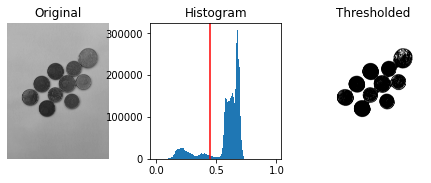

In [ ]:
import matplotlib.pyplot as plt
from skimage import data
from skimage.filters import threshold_otsu


thresh = threshold_otsu(img_g)
binary = img_g > thresh

fig, axes = plt.subplots(ncols=3, figsize=(8, 2.5))
ax = axes.ravel()
ax[0] = plt.subplot(1, 3, 1)
ax[1] = plt.subplot(1, 3, 2)
ax[2] = plt.subplot(1, 3, 3, sharex=ax[0], sharey=ax[0])

ax[0].imshow(img_g, cmap=plt.cm.gray)
ax[0].set_title('Original')
ax[0].axis('off')

ax[1].hist(img_g.ravel(), bins=256)
ax[1].set_title('Histogram')
ax[1].axvline(thresh, color='r')

ax[2].imshow(binary, cmap=plt.cm.gray)
ax[2].set_title('Thresholded')
ax[2].axis('off')

plt.show()

## Automatic computation of the threshold: Otsu method

To verify the quality of automatic threshold selection systems we can use the Otsu method. This method is an improvement of the K-Means method that takes into account not only the average value of each of the two classes but also the variance. scikit-image implements the Otsu method and proposes an automatic threshold for binarization. Execute the following statement to automatically calculate the optimal threshold with the Otsu method:

In [ ]:
from skimage import filters as ft #importing submodule for implementing otsu threshold calculation

th2 = ft.threshold_otsu(img_g)
img_b2 = img_g <= th2

# **Question 7**.
Compare the value obtained by Otsu with the threshold value that you proposed in question 6. Represent the binarized image with this threshold value and checks if it is close to what was expected.

**Answer.**
The downside of the simple thresholding technique is that we have to make an educated guess about the threshold t by inspecting the histogram. There are also automatic thresholding methods that can determine the threshold automatically for us. One such method is Otsu’s method. It is particularly useful for situations where the grayscale histogram of an image has two peaks that correspond to background and objects of interest.

The outcome is that Otsu’s method finds a threshold value between the two peaks of a grayscale histogram.



In [ ]:
# perform automatic thresholding
t = skimage.filters.threshold_otsu(blurred_image)
print("Found automatic threshold t = {}.".format(t))

Found automatic threshold t = 0.45527617844145263.



The multi-Otsu threshold 1 is a thresholding algorithm that is used to separate the pixels of an input image into several different classes, each one obtained according to the intensity of the gray levels within the image.

Multi-Otsu calculates several thresholds, determined by the number of desired classes. The default number of classes is 3: for obtaining three classes, the algorithm returns two threshold values. They are represented by a red line in the histogram below.

For this root image and a Gaussian blur with the chosen sigma of 1.0, the computed threshold value is 0.455. No we can create a binary mask with the comparison operator >. As we have seen before, pixels above the threshold value will be turned on, those below the threshold will be turned off.

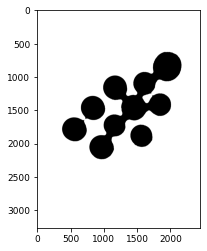

In [ ]:
# create a binary mask with the threshold found by Otsu's method
binary_mask = blurred_image > t

fig, ax = plt.subplots()
plt.imshow(binary_mask, cmap="gray")
plt.show()

I illustrate how to apply one of these [Multi-Otsu Thresholding](https://scikit-image.org/docs/stable/auto_examples/segmentation/plot_multiotsu.html)

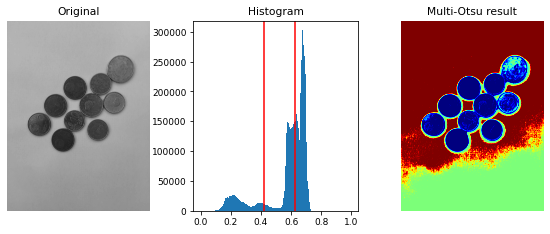

In [ ]:
import matplotlib
import matplotlib.pyplot as plt
import numpy as np

#from skimage import data
from skimage.filters import threshold_multiotsu

# Setting the font size for all plots.
matplotlib.rcParams['font.size'] = 9

thresholds = threshold_multiotsu(img_g)

# Using the threshold values, we generate the three regions.
regions = np.digitize(img_g, bins=thresholds)

fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(10, 3.5))

# Plotting the original image.
ax[0].imshow(img_g, cmap='gray')
ax[0].set_title('Original')
ax[0].axis('off')

# Plotting the histogram and the two thresholds obtained from
# multi-Otsu.
ax[1].hist(img_g.ravel(), bins=255)
ax[1].set_title('Histogram')
for thresh in thresholds:
    ax[1].axvline(thresh, color='r')

# Plotting the Multi Otsu result.
ax[2].imshow(regions, cmap='jet')
ax[2].set_title('Multi-Otsu result')
ax[2].axis('off')

plt.subplots_adjust()

plt.show()


# Morphological filtering

After binarization, noise may appear in the form of white pixels in regions that should have black pixels and vice-versa. To eliminate this noise morphological filters of erosion and dilation are often used. In order to count coins efficiently using labeling methods, our interest would be that each of the objects that appear on the screen after binarization and filtering were disconnected, ie a set of connected pixels for each coin but not-connected for different coins. To achieve these goals, we must select the sizes of structuring elements correctly.

The following sequence of instructions defines two structuring elements with a circular shape and a radius equal to unity. You must modify the radius r1 and r2 until you get an image where the different coins appear correctly segmented (that is compact but correctly separated). Execute the instruction sequence by modifying the values of r1 and r2 until the desired results are obtained.

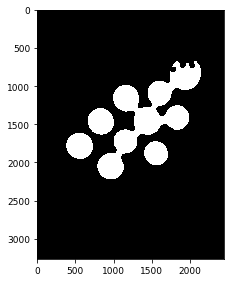

In [ ]:
# Morphological Filtering: Dilation and Erosion
import pandas_profiling as pp

from skimage import morphology as morph
r1 = 5
r2 = 35
se_dilate = morph.disk(r1)
se_erode = morph.disk(r2)

r = morph.binary_dilation(img_b2, se_dilate)
t = morph.binary_erosion(r,se_erode).astype(float)

io.imshow(t)
io.show()

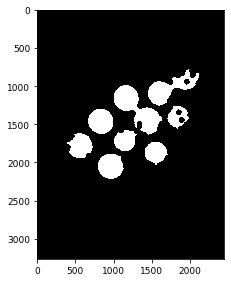

In [ ]:
# Morphological Filtering: Dilation and Erosion
import pandas_profiling as pp

from skimage import morphology as morph
r1 = 2
r2 = 38
se_dilate = morph.disk(r1)
se_erode = morph.disk(r2)

r = morph.binary_dilation(img_b2, se_dilate)
t = morph.binary_erosion(r,se_erode).astype(float)

io.imshow(t)
io.show()

with radii r1 = 2 and r2 = 30 we have a very bad segmentation

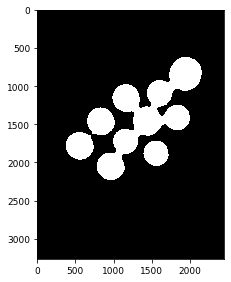

In [ ]:
# Morphological Filtering: Dilation and Erosion
import pandas_profiling as pp

from skimage import morphology as morph
r1 = 8
r2 = 30
se_dilate = morph.disk(r1)
se_erode = morph.disk(r2)

r = morph.binary_dilation(img_b2, se_dilate)
t = morph.binary_erosion(r,se_erode).astype(float)

io.imshow(t)
io.show()

The best values that I found are r1= 8 and r2 = 30 in this way the segmentation is good and all the coins are correctly segmented.

# **Question 8.** 
Write the values of r1 and r2 that you considered to be the best.

**Answer.**

The best values that I found are r1= 8 and r2 = 30 in this way the segmentation is good and all the coins are correctly segmented.


### Labelling and Counting Coins

Finally, to perform the labeling and counting of elements of the binary image we can use the instruction label that returns a labeled image and the number of objects in the image. The following sequence of instructions also provides an algorithm that converts every number in the labeled image to a different color, to help verification of the quality in the segmentation (all the coins should have different colors).

10
10


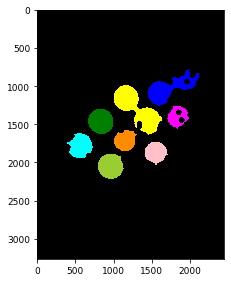

In [ ]:
# Labelling and Counting the number of coins

img_labeled, num_coins = morph.label(t, return_num = True)
print(num_coins)
print(img_labeled.max())

imgcolor = cl.label2rgb(img_labeled,bg_label=0)

io.imshow(imgcolor)
io.show()

# **Question 9.** 
Modify, if necessary, the different filtering parameters (r1 and r2) until you get a correct result and the number of coins entered is correct. Provide the selected r1 and r2 values again.

**Answer.**
This question shows how to segment an image with image labelling.
 The following steps are applied:

1. Thresholding with automatic Otsu method

2. Close small holes with binary closing

3. Remove artifacts touching image border

4. 
Measure image regions to filter small objects

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches

from skimage import data
from skimage.filters import threshold_otsu
from skimage.segmentation import clear_border
from skimage.measure import label, regionprops
from skimage.morphology import closing, square
from skimage.color import label2rgb

img = io.imread('Monedas1.JPG')#[50:-50, 50:-50]
img_g = rgb2gray(img)

# apply threshold
thresh = threshold_otsu(img_g)
bw = closing(img_g > thresh, square(3))

# remove artifacts connected to image border
cleared = bw.copy()
clear_border(cleared)
# label image regions
label_image = label(cleared)
borders = np.logical_xor(bw, cleared)
label_image[borders] = -1


fig, ax = plt.subplots(ncols=1, nrows=1, figsize=(6, 6))
ax.imshow(label_image, cmap='jet')

for region in regionprops(label_image, ['Area', 'BoundingBox']):

    # skip small images
    if region['Area'] < 100:
        continue

    # draw rectangle around segmented coins
    minr, minc, maxr, maxc = region['BoundingBox']
    rect = mpatches.Rectangle((minc, minr), maxc - minc, maxr - minr,
                              fill=False, edgecolor='red', linewidth=2)
    ax.add_patch(rect)

plt.show()

NameError: ignored

count coins with [opencv](https://programarfacil.com/blog/vision-artificial/detector-de-bordes-canny-opencv/)
1. Convert the image to grayscale
2. Filter the image to remove noise
3. Apply the Canny edge detector
4. Find the contours within the detected edges
5. Draw these contours

I have found 524 objects


-1

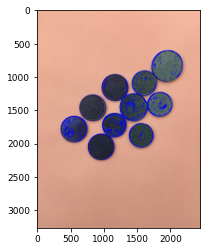

In [ ]:

import numpy as np
import matplotlib.pyplot as plt
import cv2

img = cv2.imread('Monedas1.JPG')
plt.imshow(img)

img_g = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
 

gauss = cv2.GaussianBlur(img_g, (5,5), 0)
 
plt.imshow( gauss)
 

canny = cv2.Canny(gauss, 50, 150)
 
plt.imshow(canny)
 

(contours,_) = cv2.findContours(canny.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
 

print("I have found {} objects".format(len(contours)))
 
cv2.drawContours(img,contours,-1,(0,0,255), 2)
plt.imshow( img)
 
cv2.waitKey(0)

In [ ]:
def hough_circle_detection(img, min_r, max_r):
    # turn original image to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)  
    # blur grayscale image
    blurred = cv2.medianBlur(gray, 5)  
    return cv2.HoughCircles(
        blurred,  # source image (blurred and grayscaled)
        cv2.HOUGH_GRADIENT,  # type of detection
        1,  # inverse ratio of accumulator res. to image res.
        40,  # minimum distance between the centers of circles
        param1=50,  # Gradient value passed to edge detection
        param2=30,  # accumulator threshold for the circle centers
        minRadius=min_r*2,  # min circle radius
        maxRadius=max_r*2,  # max circle radius
    )

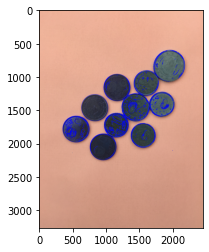

In [ ]:
plt.imshow(img)

In [ ]:
!pip install opencv-contrib-python

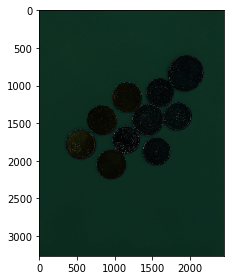

In [ ]:
from skimage import data, io, filters

img = io.imread('Monedas1.JPG')
# ... or any other NumPy array!
edges = filters.sobel(img)
io.imshow(edges)
io.show()

# **Final Exercise**

For the next exercise, you can group the different instructions executed for finding the number of coins in our example. You can use these instructions as a program for the next exercise, modifying those parameters that you consider necessary.

##**Part 1.** 
Take a set of coins, spread them on a table and take a picture with the mobile (try not to overlap the coins so that the counting is correct, although they may be in contact). Determine the number of coins in the photo using the previous program and change the parameters if necessary. Provide, as a result of the exercise, the original image (in color) and the final image with the different colors assigned to each object that we get after labeling them and the final code used for counting the number of coins

#**Part 2.** 

Define a method that you could use to count the different types of coins. To simplify you may suppose that you only have 2€, 1€, 50 cent, 20 cent, 10 cent and 5 cent coins. Have into account the possible scale variations, depending on the distance that the images are taken (scale invariance), the color of the coins, the relative sizes, etc. **You just have to describe the algorithm 'conceptually', without implementing the code**. The implementation of the code is optional and it is not trivial to get a robust code to solve the problem. I only recommend to implement part 3 if you are highly motivated and have time!

#**Part 3. (Optional)** 

Write a software in Python implementing the counting. Provide the software code and some images to test it.



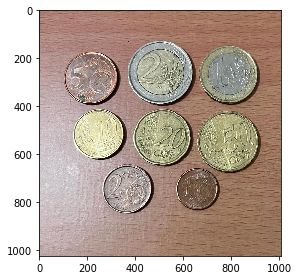

In [ ]:
#Here is my own coins
from skimage import io
img1 = io.imread('Coins.jpg') # Be careful when openning a file .. It is case sensitive
io.imshow(img1)
io.show()

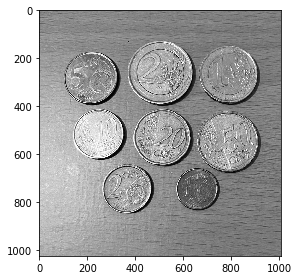

In [ ]:
# conver to gray
from skimage import color as cl

img_g1 = cl.rgb2gray(img1)
io.imshow(img_g1)

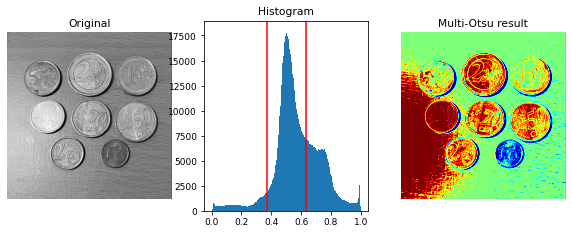

In [ ]:
import matplotlib
import matplotlib.pyplot as plt
import numpy as np

#from skimage import data
from skimage.filters import threshold_multiotsu

# Setting the font size for all plots.
matplotlib.rcParams['font.size'] = 9

thresholds = threshold_multiotsu(img_g1)

# Using the threshold values, we generate the three regions.
regions = np.digitize(img_g1, bins=thresholds)

fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(10, 3.5))

# Plotting the original image.
ax[0].imshow(img_g1, cmap='gray')
ax[0].set_title('Original')
ax[0].axis('off')

# Plotting the histogram and the two thresholds obtained from
# multi-Otsu.
ax[1].hist(img_g1.ravel(), bins=255)
ax[1].set_title('Histogram')
for thresh in thresholds:
    ax[1].axvline(thresh, color='r')

# Plotting the Multi Otsu result.
ax[2].imshow(regions, cmap='jet')
ax[2].set_title('Multi-Otsu result')
ax[2].axis('off')

plt.subplots_adjust()

plt.show()

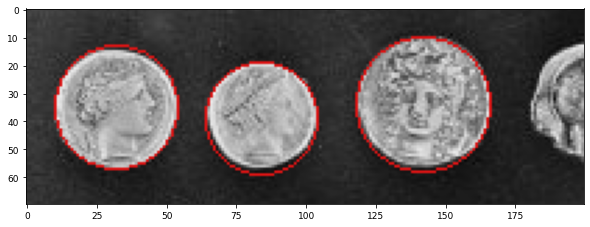

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

from skimage import data, color
from skimage.transform import hough_circle, hough_circle_peaks
from skimage.feature import canny
from skimage.draw import circle_perimeter
from skimage.util import img_as_ubyte


# Load picture and detect edges
#img_g1 = cl.rgb2gray(img1)
image = img_as_ubyte(data.coins()[160:230, 70:270])
edges = canny(image, sigma=3, low_threshold=10, high_threshold=50)


# Detect two radii
hough_radii = np.arange(20, 35, 2)
hough_res = hough_circle(edges, hough_radii)

# Select the most prominent 3 circles
accums, cx, cy, radii = hough_circle_peaks(hough_res, hough_radii,
                                           total_num_peaks=3)

# Draw them
fig, ax = plt.subplots(ncols=1, nrows=1, figsize=(10, 4))
image = color.gray2rgb(image)
for center_y, center_x, radius in zip(cy, cx, radii):
    circy, circx = circle_perimeter(center_y, center_x, radius,
                                    shape=image.shape)
    image[circy, circx] = (220, 20, 20)

ax.imshow(image, cmap=plt.cm.gray)
plt.show()

In [ ]:
import cv2
from google.colab.patches import cv2_imshow
img1 = cv2.imread('Coins.jpg')
gray = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)
_,th =  cv2.threshold(gray, 240, 255, cv2.THRESH_BINARY_INV)
#Para OpenCV 3
_,cnts,_ = cv2.findContours(th, cv2.RETR_EXTERNAL,
  cv2.CHAIN_APPROX_SIMPLE)
#for OpenCV 4
#cnts,_ = cv2.findContours(th, cv2.RETR_EXTERNAL,
#    cv2.CHAIN_APPROX_SIMPLE)
#cv2.drawContours(imagen, cnts, -1, (255,0,0),2)
#print('Contornos: ', len(cnts))
font = cv2.FONT_HERSHEY_SIMPLEX
i=0
for c in cnts:
  M=cv2.moments(c)
  if (M["m00"]==0): M["m00"]=1
  x=int(M["m10"]/M["m00"])
  y=int(M['m01']/M['m00'])
  mensaje = 'Num :' + str(i+1)
  cv2.putText(img1,mensaje,(x-40,y),font,0.75,
    (255,0,0),2,cv2.LINE_AA)
  cv2.drawContours(img1, [c], 0, (255,0,0),2)
  cv2.imshow('Image', img1)
  cv2.waitKey(0)
  i = i+1
cv2.destroyAllWindows()

ValueError: ignored

Contornos:  128


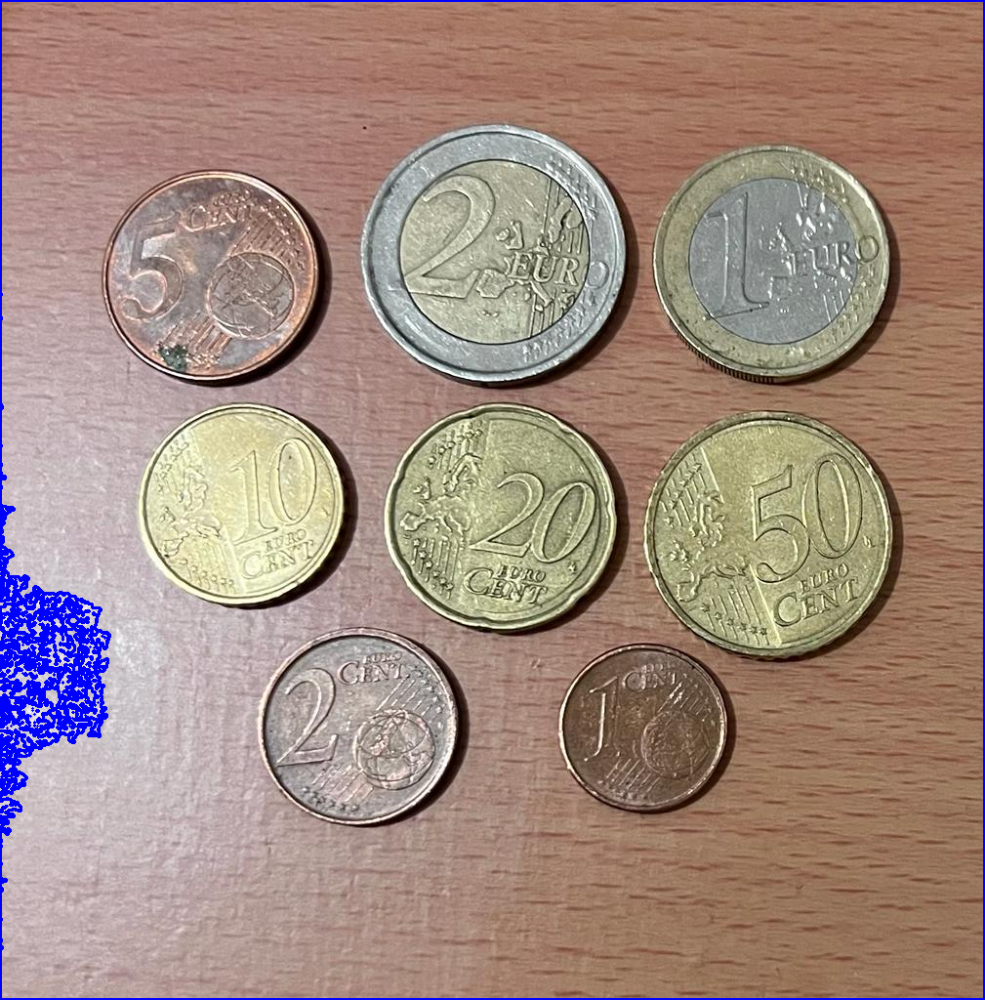

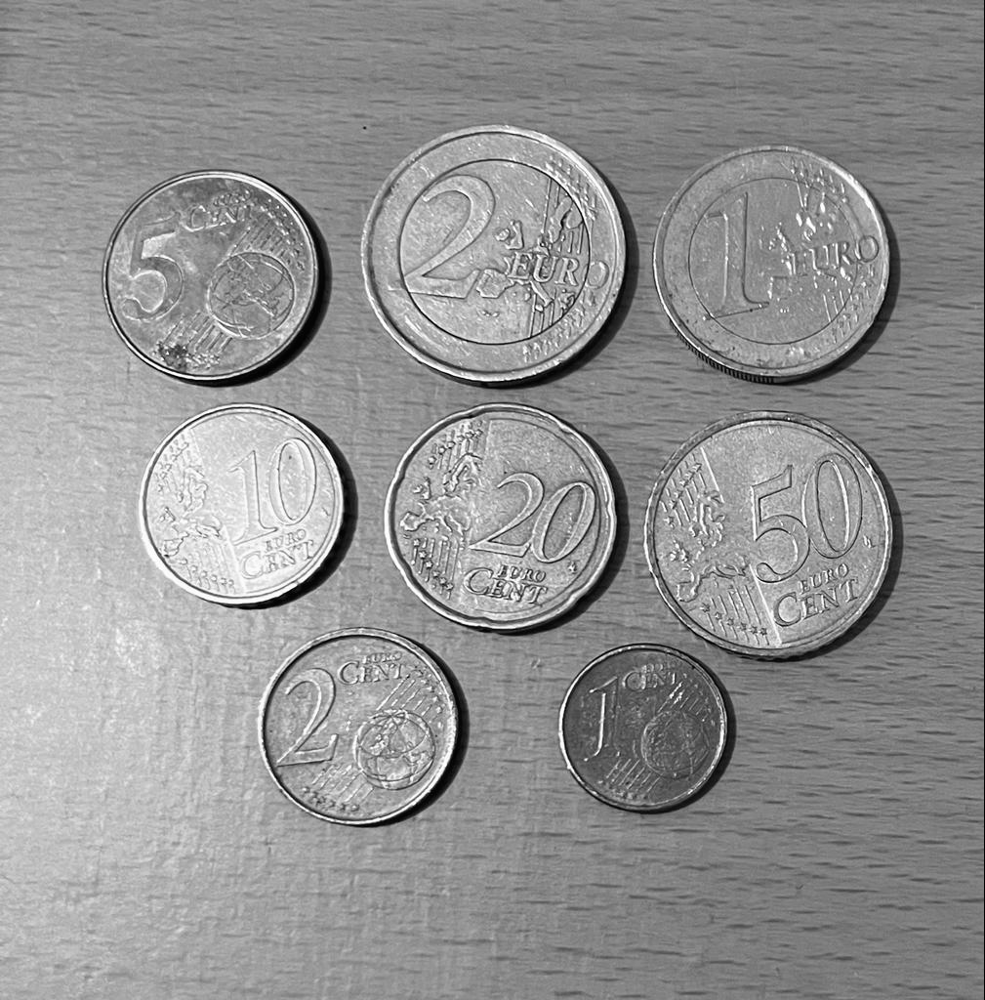

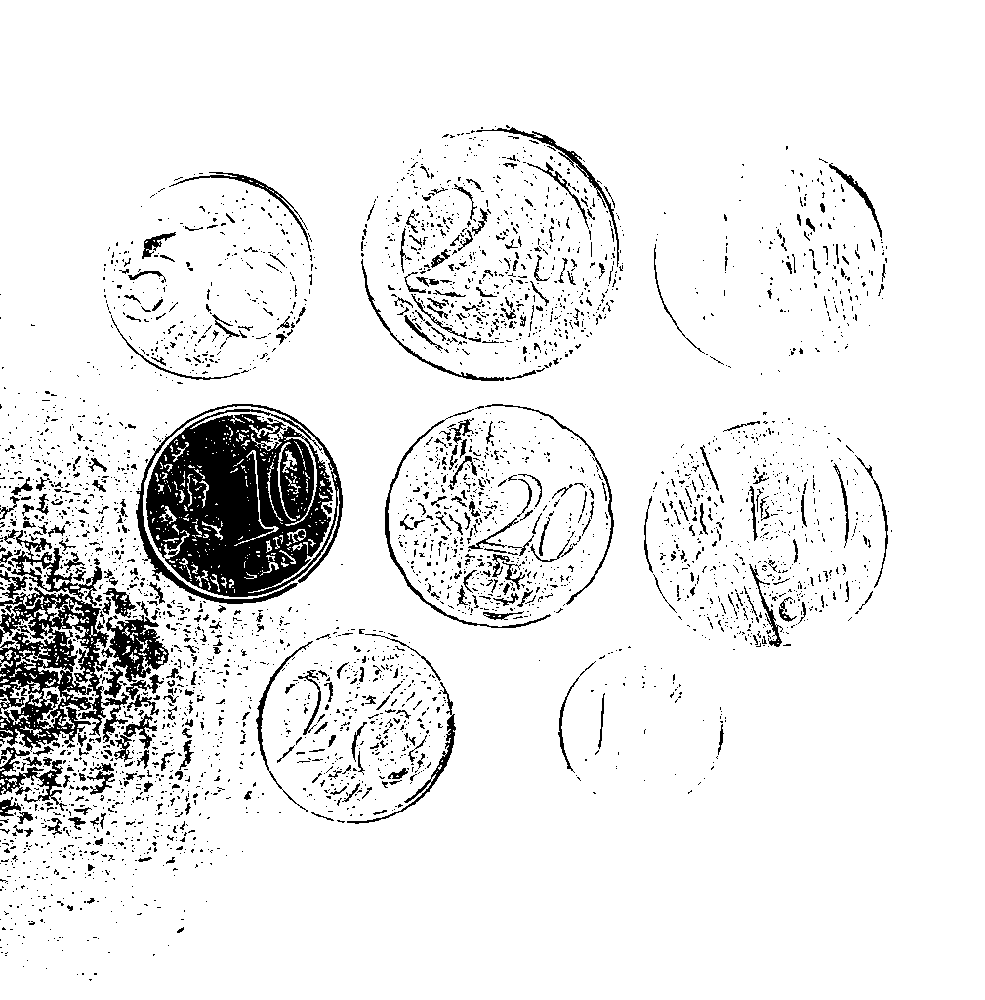

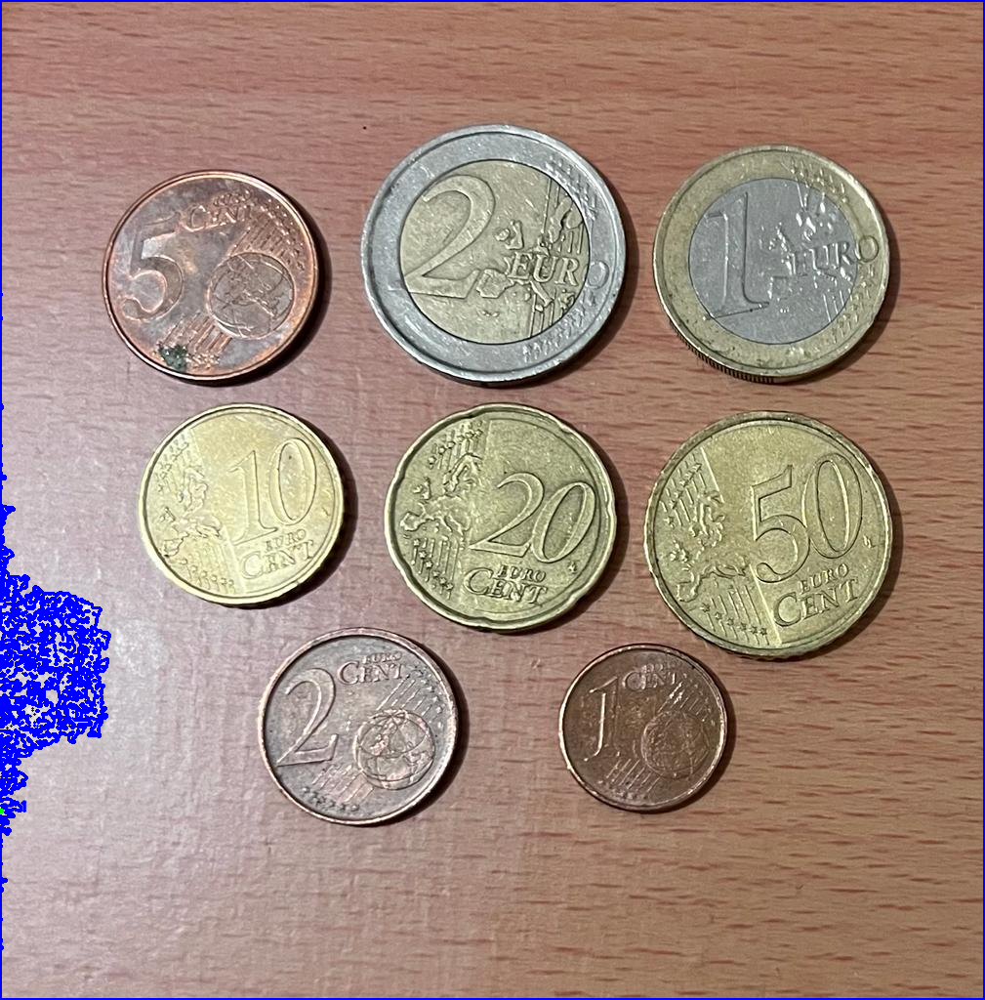

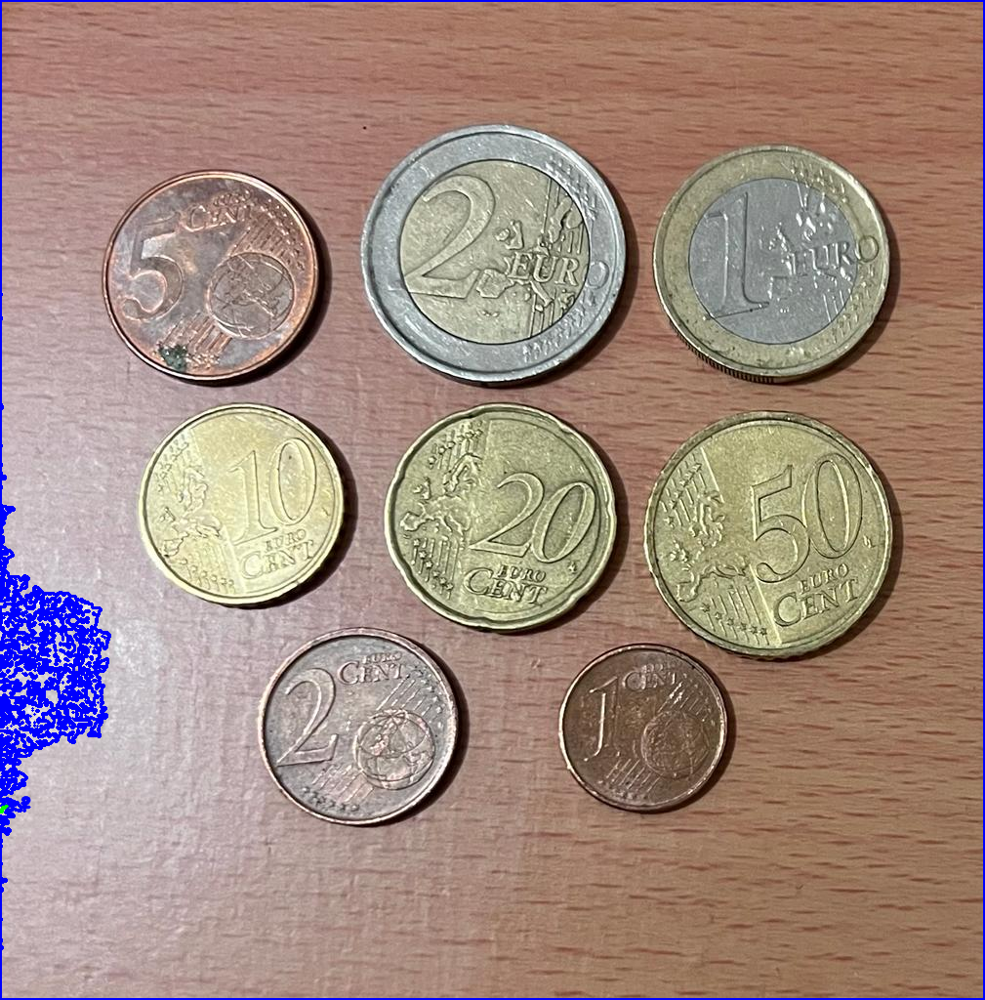

...

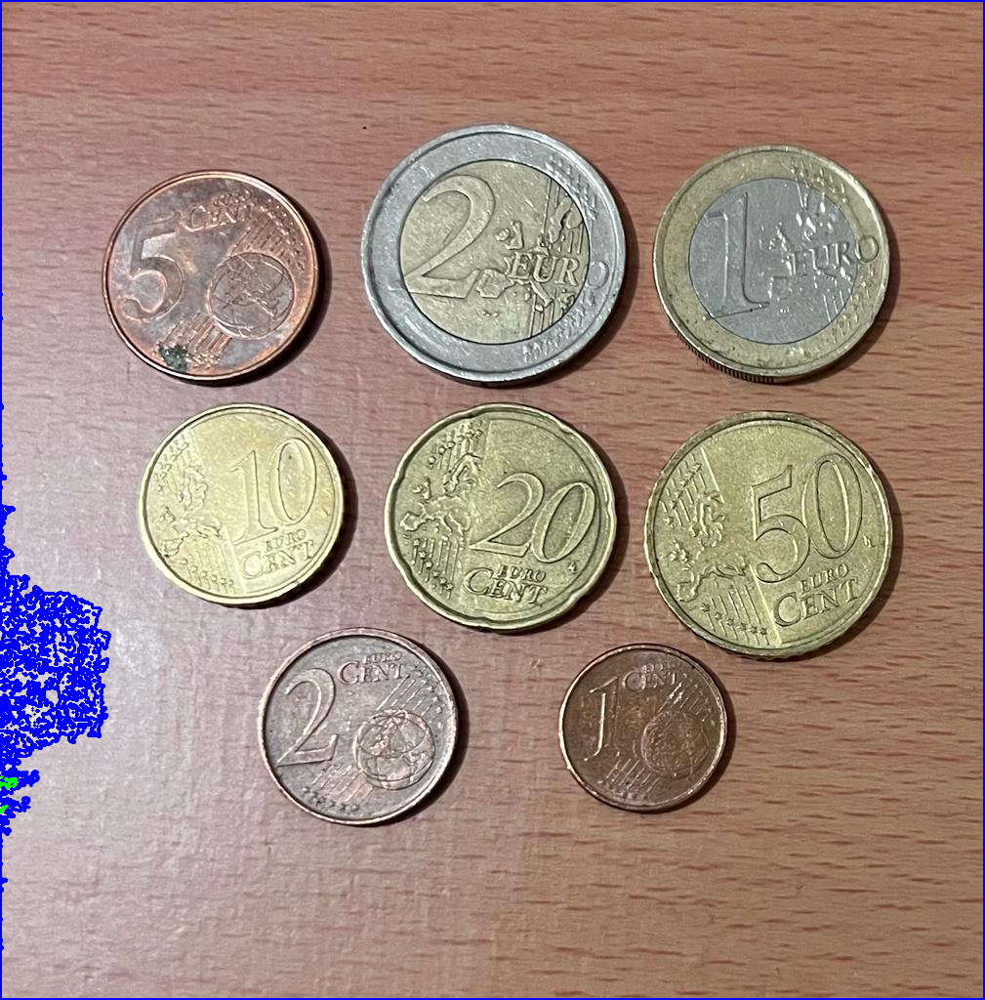

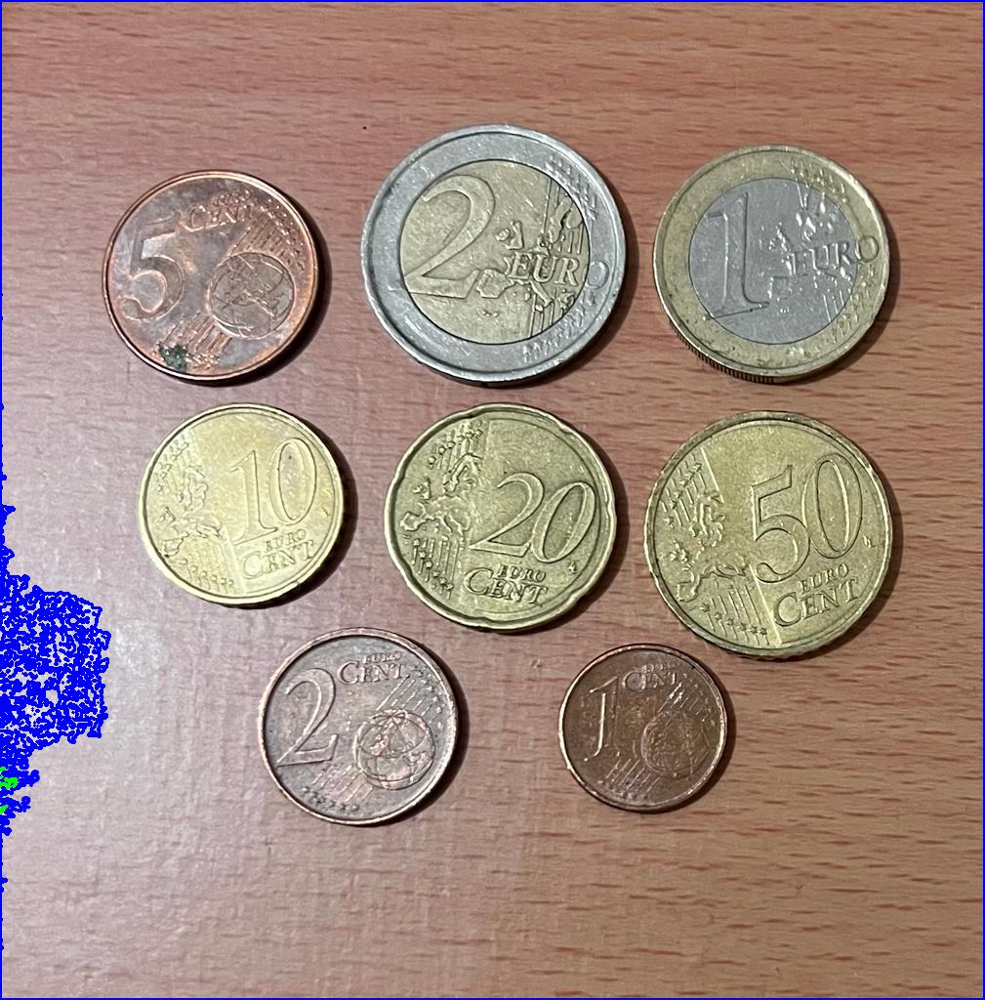

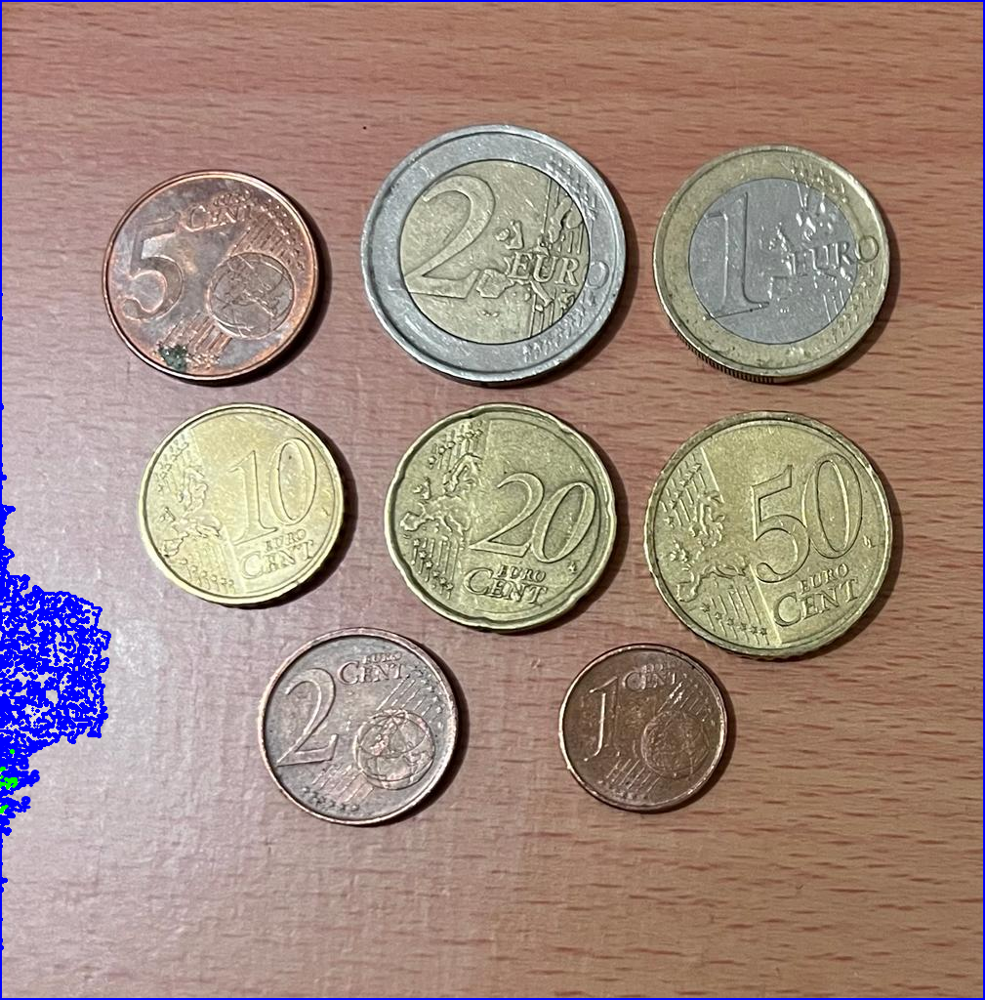

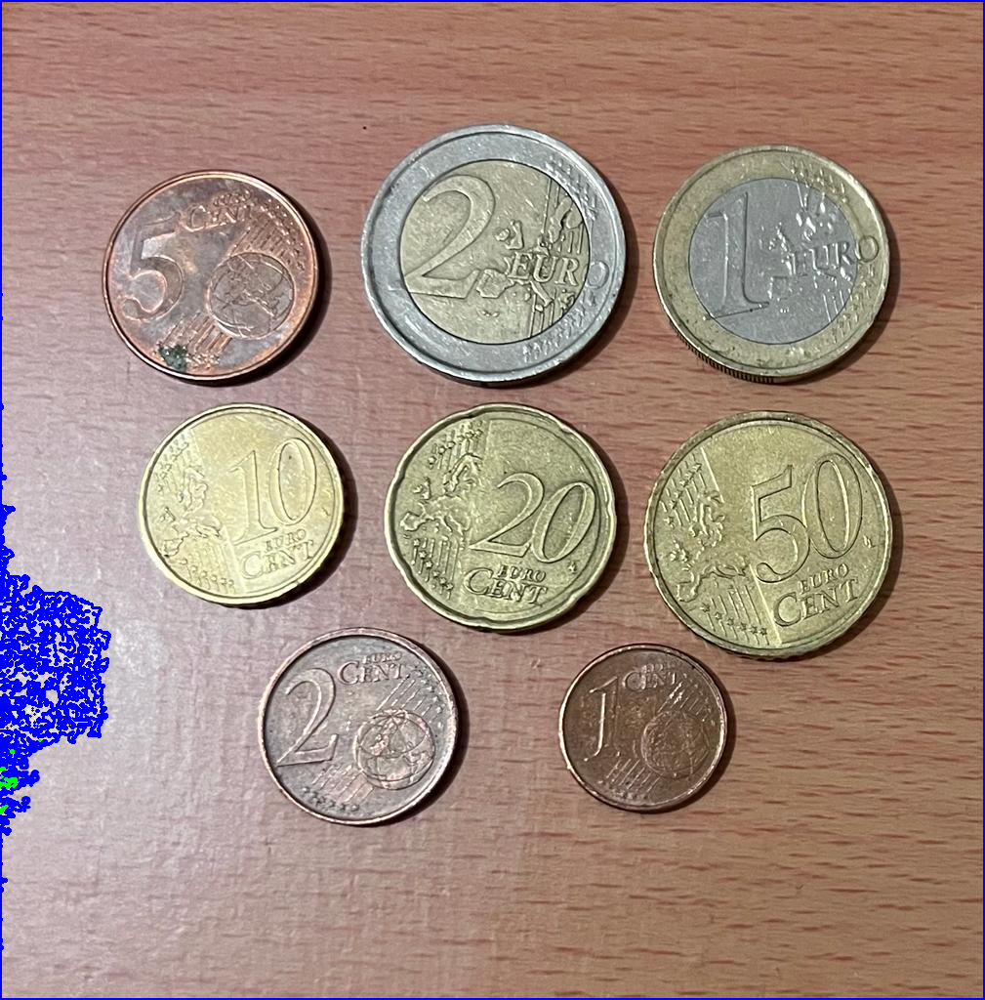

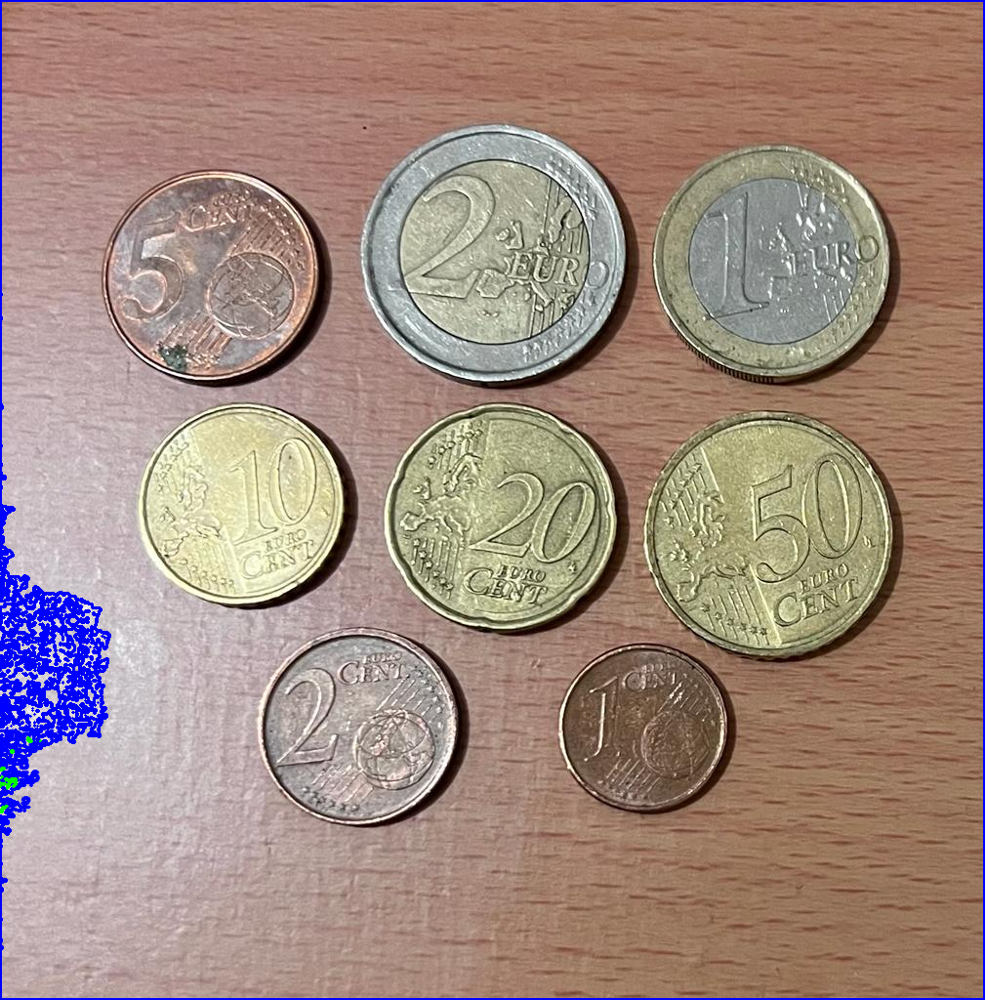

In [ ]:
import cv2
# upload coin
img = cv2.imread('Coins.jpg')
#RGB TO GRAY
grises = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
_,th = cv2.threshold(grises, 200,255, cv2.THRESH_BINARY_INV)
cnts,_ =cv2.findContours(th, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

cv2.drawContours(img, cnts, -1, (255,0,0), 2)
print ('Contornos: ', len(cnts))


cv2_imshow(img)
cv2_imshow(grises)
cv2_imshow(th)
#cv2.waitKey(0)
#cv2.destroyAllWindows()

font =cv2.FONT_HERSHEY_SIMPLEX
i=0
for c in cnts:
    M =cv2.moments(c)
    if (M["m00"]==0): M["m00"]=1
    x = int(M["m10"]/M["m00"])
    y = int(M["m01"]/M["m00"])

    mensaje ='Num: ' + str(i+1)
    cv2.putText(img, mensaje, (x-25,y), font, 0.45, (255,0,0),2,cv2.LINE_AA)
    cv2.drawContours(img,[c], 0, (0,255,0),2)
    cv2_imshow(img)
    cv2.waitKey(0)
    i= i+1

cv2.destroyAllWindows()

Counting_coins,In colab I don't know how to make it work

In [ ]:
from __future__ import print_function
import numpy as np
import argparse
import cv2

ap = argparse.ArgumentParser("Desciption: ")
ap.add_argument("-i","--image", required = True, help = "/content/drive/My Drive/Colab Notebooks/IMAGE/CE1")
b = vars(ap.parse_args())

img1 = cv2.imread(b["Coins"])
cv2_imshow("Original",img1)
cv2.waitKey(0)

gray = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)
blurred = cv2.GaussianBlur(gray,(9,9),0) # blur with standard deviation sigma = 9
cv2_imshow("Blurred",blurred)
cv2.waitKey(0)

edge = cv2.Canny(blurred,30,150) # below 30 non edges and above 150 are sure edge
cv2_imshow("Canny_edged",edge)
cv2.waitKey(0)

(_,cnts,_) = cv2.findContours(edge.copy(),cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE) # first argument we make a copy second argument is the outermost Contours
# third argument is the compress horizontal, vertical and diagonal segments into their end points only 
print("I count {} coins in the image".format(len(cnts)))
coins = image.copy()
#cv2.drawContours(coins,cnts,-1,(0,255,0),2) # first argument is the image second is the contours -1 means we want to draw all the Contours providing 1,2,3 .. will print the associated Contours
# fourth argument is the color we want to draw around the Contours. last argument is the thickness of our Contours

for i in range(0,len(cnts)):
 cv2.drawContours(coins,cnts,i,(0,255,0),2)
 cv2_imshow("Coins",coins)
 cv2.waitKey(0)

for (i, c) in enumerate(cnts):# we are iterating through our contours
 (x, y, w, h) = cv2.boundingRect(c) # x and y are starting point of rectangle in first contours

 print("Coin #{}".format(i + 1))
 coin = image[y:y + h, x:x + w] #cropping image as same height and width as the contours
 cv2_imshow("Coin", coin)

 mask = np.zeros(image.shape[:2], dtype = "uint8") #initialising mask of same height and width as image
 ((centerX, centerY), radius) = cv2.minEnclosingCircle(c) # extracting the centre of circle and radius of the circle
 cv2.circle(mask, (int(centerX), int(centerY)), int(radius),255, -1) #
 mask = mask[y:y + h, x:x + w]
 cv2.imshow("Masked Coin", cv2.bitwise_and(coin, coin, mask = mask)) # finally applying the AND operation on coins using mask
 cv2.waitKey(0)

usage: Desciption:  [-h] -i IMAGE
Desciption: : error: the following arguments are required: -i/--image


SystemExit: ignored

/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2890: UserWarning: To exit: use 'exit', 'quit', or Ctrl-D.
  warn("To exit: use 'exit', 'quit', or Ctrl-D.", stacklevel=1)
